# Libraries

In [1]:
# default libraries
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

In [2]:
# plotting configuration
sns.set(style = 'darkgrid',
        font_scale = 1.4,
        rc = {"lines.linewidth": 2,
          "figure.figsize": (12, 8)})

sns.set_palette('Set2')

In [3]:
# load implemented packages
from hyp_tests import jackknife_cookie_bucket_mean,\
jackknife_cookie_bucket_quantile,compute_quantile_hist_data, jackknife_cookie_bucket_quantile_binned,\
jackknife_cookie_bucket_mean_binned
from data_gen import generate_raw_data, get_binned_data
from tools import get_exponential_bins

# Simulate data

In [4]:
raw_data_group_1 = generate_raw_data(number_of_users = 50000) 
raw_data_group_2 = generate_raw_data(number_of_users = 50000) 

In [5]:
raw_data_group_1

,Client ID,Metric Value
0,0.0,2921.940335
1,0.0,10259.238404
2,0.0,277.074890
3,1.0,3511.961641
4,1.0,439.540111
...,...,...
1665386,49999.0,808.533931
1665387,49999.0,1288.035372
1665388,49999.0,7677.208596
1665389,49999.0,6094.882956


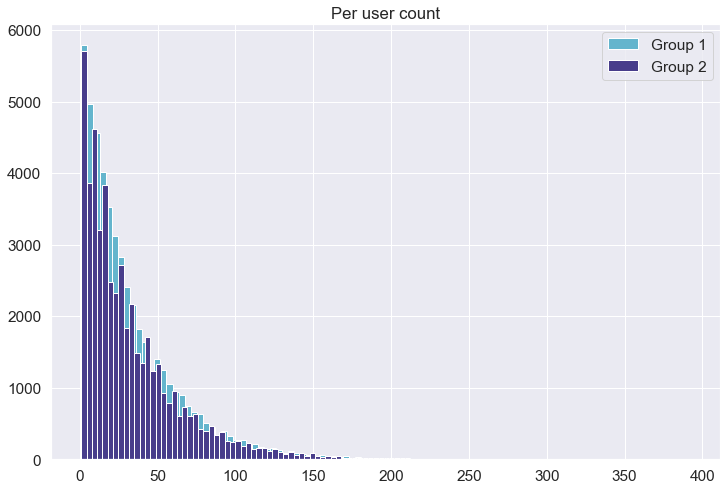

In [6]:
plt.hist(raw_data_group_1.groupby('Client ID').count().values, bins=100, label='Group 1', color='c')
plt.hist(raw_data_group_2.groupby('Client ID').count().values, bins=100, label='Group 2', color='darkslateblue')
plt.title('Per user count')
plt.legend()
plt.show()

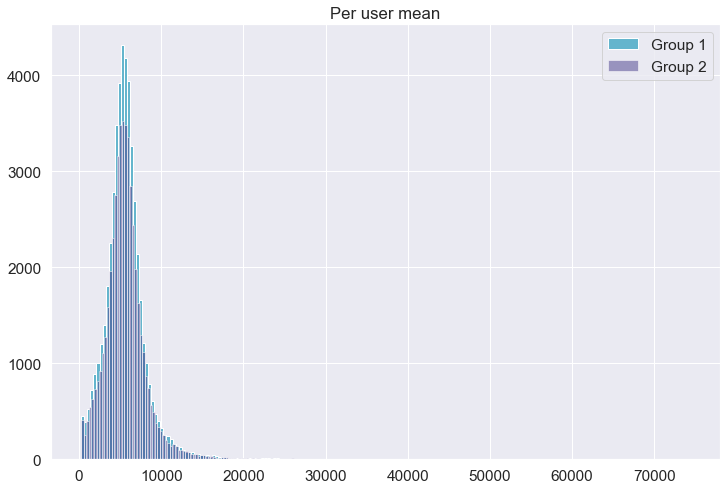

In [7]:
plt.hist(raw_data_group_1.groupby('Client ID').mean().values, bins=200, label='Group 1', color='c')
plt.hist(raw_data_group_2.groupby('Client ID').mean().values, bins=200, label='Group 2', alpha=0.5, color='darkslateblue')
plt.title('Per user mean')
#plt.xlim([0,20000])
plt.legend()
plt.show()

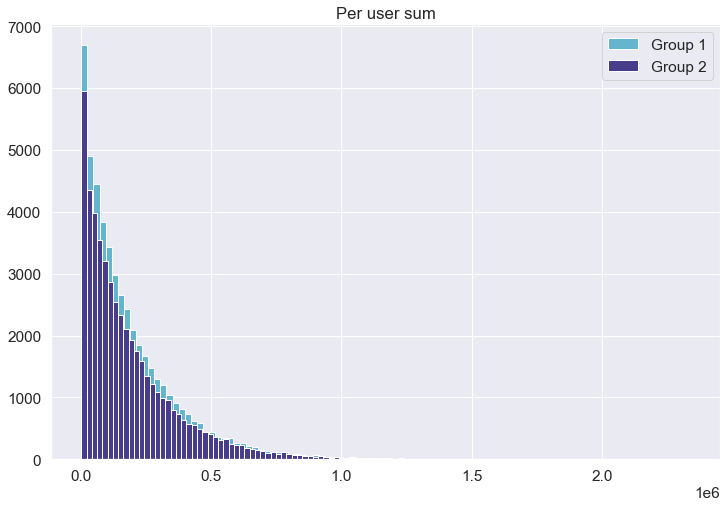

In [8]:
plt.hist(raw_data_group_1.groupby('Client ID').sum().values, bins=100, label='Group 1', color='c')
plt.hist(raw_data_group_2.groupby('Client ID').sum().values, bins=100, label='Group 2', color='darkslateblue')
plt.title('Per user sum')
plt.legend()
plt.show()

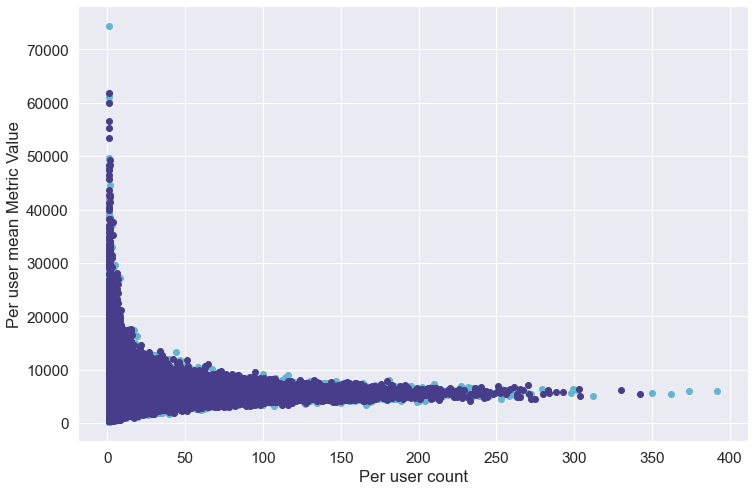

In [9]:
plt.scatter(raw_data_group_1.groupby('Client ID').count(), raw_data_group_1.groupby('Client ID').mean(), label='Group 1', color='c')
plt.scatter(raw_data_group_2.groupby('Client ID').count(), raw_data_group_2.groupby('Client ID').mean(), label='Group 2', color='darkslateblue')
plt.xlabel('Per user count')
plt.ylabel('Per user mean Metric Value')
plt.show()

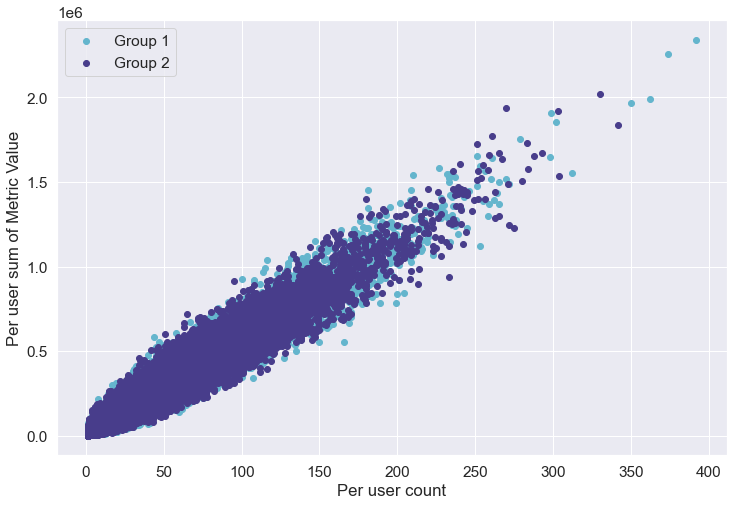

In [10]:
plt.scatter(raw_data_group_1.groupby('Client ID').count(), raw_data_group_1.groupby('Client ID').sum(), label='Group 1', color='c')
plt.scatter(raw_data_group_2.groupby('Client ID').count(), raw_data_group_2.groupby('Client ID').sum(), label='Group 2', color='darkslateblue')
plt.xlabel('Per user count')
plt.ylabel('Per user sum of Metric Value')
plt.legend()
plt.show()

# Getting binned data

In [11]:
bins_boundaries = get_exponential_bins(10,600000,100)

In [12]:
# given raw data, make histogram data
binned_data_group_1 = get_binned_data(raw_data_group_1, bins_boundaries)
binned_data_group_2 = get_binned_data(raw_data_group_2, bins_boundaries)

In [13]:
binned_data_group_1

,Client ID,Bin 0,Bin 1,Bin 2,Bin 3,Bin 4,Bin 5,Bin 6,Bin 7,Bin 8,...,Bin 90,Bin 91,Bin 92,Bin 93,Bin 94,Bin 95,Bin 96,Bin 97,Bin 98,Bin 99
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,49995.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49996,49996.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49997,49997.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49998,49998.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
binned_data_group_1.loc[1].values

array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
       0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
       0., 1., 0., 2., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 2., 0., 1.,
       1., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

# Multiple simulations

## effect size for the median

In [18]:
num_of_simulations = 1000

In [19]:
# 1 will correspond to rejecting the null
coverage_results = list()

for cur_sim in range(num_of_simulations): 
    # simulate data
    raw_data_group_1 = generate_raw_data(number_of_users = 3000) 
    raw_data_group_2 = generate_raw_data(number_of_users = 3000) 
    # given raw data, make histogram data
    binned_data_group_1 = get_binned_data(raw_data_group_1, bins_boundaries)
    binned_data_group_2 = get_binned_data(raw_data_group_2, bins_boundaries)

    # perform test
    ci_center, ci_width = jackknife_cookie_bucket_quantile_binned(binned_data_group_1, binned_data_group_2, bins_boundaries, 20, 0.95, 0.5)

    if (ci_center - ci_width < 0) and  (ci_center + ci_width > 0):
        coverage_results += [0]
    else:
        coverage_results += [1]

In [20]:
print('Rejection rate: {:2.2%}'.format(np.mean(coverage_results)))

Rejection rate: 4.60%


In [21]:
raw_data_group_1

,Client ID,Metric Value
0,0.0,1562.301293
1,0.0,9326.877354
2,0.0,654.154532
3,0.0,960.756191
4,0.0,551.471251
...,...,...
100290,2998.0,8306.631603
100291,2998.0,730.322327
100292,2998.0,1017.785742
100293,2999.0,275.246153


### 95-th percentile

In [22]:
# 1 will correspond to rejecting the null
coverage_results = list()

for cur_sim in range(num_of_simulations): 
    # simulate data
    raw_data_group_1 = generate_raw_data(number_of_users = 3000) 
    raw_data_group_2 = generate_raw_data(number_of_users = 3000) 
    # given raw data, make histogram data
    binned_data_group_1 = get_binned_data(raw_data_group_1, bins_boundaries)
    binned_data_group_2 = get_binned_data(raw_data_group_2, bins_boundaries)

    # perform test
    ci_center, ci_width = jackknife_cookie_bucket_quantile_binned(binned_data_group_1, binned_data_group_2, bins_boundaries, 20, 0.95, 0.95)

    if (ci_center - ci_width < 0) and  (ci_center + ci_width > 0):
        coverage_results += [0]
    else:
        coverage_results += [1]

In [23]:
print('Rejection rate: {:2.2%}'.format(np.mean(coverage_results)))

Rejection rate: 4.90%


### More users

#### median

In [24]:
num_of_simulations = 2000

In [ ]:
# 1 will correspond to rejecting the null
coverage_results = list()

for cur_sim in range(num_of_simulations): 
    # simulate data
    raw_data_group_1 = generate_raw_data(number_of_users = 5000) 
    raw_data_group_2 = generate_raw_data(number_of_users = 5000) 
    # given raw data, make histogram data
    binned_data_group_1 = get_binned_data(raw_data_group_1, bins_boundaries)
    binned_data_group_2 = get_binned_data(raw_data_group_2, bins_boundaries)

    # perform test
    ci_center, ci_width = jackknife_cookie_bucket_quantile_binned(binned_data_group_1, binned_data_group_2, bins_boundaries, 20, 0.95, 0.5)

    if (ci_center - ci_width < 0) and  (ci_center + ci_width > 0):
        coverage_results += [0]
    else:
        coverage_results += [1]

In [ ]:
print('Rejection rate: {:2.2%}'.format(np.mean(coverage_results)))

#### 95th percentile

In [ ]:
# 1 will correspond to rejecting the null
coverage_results = list()

for cur_sim in range(num_of_simulations): 
    # simulate data
    raw_data_group_1 = generate_raw_data(number_of_users = 3000) 
    raw_data_group_2 = generate_raw_data(number_of_users = 3000) 
    # given raw data, make histogram data
    binned_data_group_1 = get_binned_data(raw_data_group_1, bins_boundaries)
    binned_data_group_2 = get_binned_data(raw_data_group_2, bins_boundaries)

    # perform test
    ci_center, ci_width = jackknife_cookie_bucket_quantile_binned(binned_data_group_1, binned_data_group_2, bins_boundaries, 20, 0.95, 0.95)

    if (ci_center - ci_width < 0) and  (ci_center + ci_width > 0):
        coverage_results += [0]
    else:
        coverage_results += [1]

In [ ]:
print('Rejection rate: {:2.2%}'.format(np.mean(coverage_results)))